In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from shapely.geometry import Point, Polygon, LineString

In [3]:
from matplotlib import font_manager, rc
rc('font', family='AppleGothic')

plt.rcParams['axes.unicode_minus'] = False

# Bus station 위치정보

In [4]:
bus_station = pd.read_csv('data/bus_station/bus_station.csv', encoding='cp949')
bus_station

,표준ID,ARS-ID,정류소명,X좌표,Y좌표
0,100000001,1001,종로2가사거리,126.987786,37.569764
1,100000002,1002,창경궁.서울대학교병원,126.996520,37.579179
2,100000003,1003,명륜3가.성대입구,126.998290,37.582709
3,100000004,1004,종로2가.삼일교,126.987507,37.568582
4,100000005,1005,혜화동로터리.여운형활동터,127.001694,37.586230
...,...,...,...,...,...
10916,124000334,25995,우성아파트,127.139326,37.550442
10917,124000333,25996,우성아파트,127.140052,37.550620
10918,124000332,25997,조일약국,127.123477,37.533686
10919,124000331,25998,성내시장,127.125410,37.536199


In [5]:
bus_station.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10921 entries, 0 to 10920
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   표준ID    10921 non-null  int64  
 1   ARS-ID  10921 non-null  int64  
 2   정류소명    10921 non-null  object 
 3   X좌표     10921 non-null  float64
 4   Y좌표     10921 non-null  float64
dtypes: float64(2), int64(2), object(1)
memory usage: 426.7+ KB


In [6]:
bus_station.shape

(10921, 5)

In [7]:
bus_station.columns

Index(['표준ID', 'ARS-ID', '정류소명', 'X좌표', 'Y좌표'], dtype='object')

In [8]:
bs_seoul = bus_station.loc[:,['표준ID', '정류소명', 'X좌표', 'Y좌표']]
bs_seoul

,표준ID,정류소명,X좌표,Y좌표
0,100000001,종로2가사거리,126.987786,37.569764
1,100000002,창경궁.서울대학교병원,126.996520,37.579179
2,100000003,명륜3가.성대입구,126.998290,37.582709
3,100000004,종로2가.삼일교,126.987507,37.568582
4,100000005,혜화동로터리.여운형활동터,127.001694,37.586230
...,...,...,...,...
10916,124000334,우성아파트,127.139326,37.550442
10917,124000333,우성아파트,127.140052,37.550620
10918,124000332,조일약국,127.123477,37.533686
10919,124000331,성내시장,127.125410,37.536199


In [9]:
bs_seoul.sort_values(by='표준ID')

,표준ID,정류소명,X좌표,Y좌표
0,100000001,종로2가사거리,126.987786,37.569764
1,100000002,창경궁.서울대학교병원,126.996520,37.579179
2,100000003,명륜3가.성대입구,126.998290,37.582709
3,100000004,종로2가.삼일교,126.987507,37.568582
4,100000005,혜화동로터리.여운형활동터,127.001694,37.586230
...,...,...,...,...
10810,124900122,고덕역1번출구,127.153239,37.555486
10802,124900123,명일신동아아파트,127.152752,37.552314
10807,124900124,주양쇼핑,127.152922,37.552408
10912,124900125,강동리버스트4단지,127.170805,37.573357


# Bus_Station_이용 인원정보

In [10]:
bs_info = pd.read_csv('data/bus_station/bs_number_of_passengers.csv',encoding='cp949')
bs_info.head()

,사용일자,노선번호,노선명,표준버스정류장ID,버스정류장ARS번호,역명,승차총승객수,하차총승객수,등록일자
0,20210707,N37,N37번(진관공영차고지~송파공영차고지),100000001,01001,종로2가사거리,5,4,20210710
1,20210707,741,741번(진관차고지~헌인릉입구),100000001,01001,종로2가사거리,270,224,20210710
2,20210707,470,470번(상암차고지~안골마을),100000001,01001,종로2가사거리,283,190,20210710
3,20210707,N37,N37번(송파공영차고지~진관공영차고지),100000001,01001,종로2가사거리,2,4,20210710
4,20210707,171,171번(용마문화복지센터~월드컵파크7단지),100000002,01002,창경궁.서울대학교병원,235,162,20210710


In [11]:
bs_info.tail()

,사용일자,노선번호,노선명,표준버스정류장ID,버스정류장ARS번호,역명,승차총승객수,하차총승객수,등록일자
1423928,20210601,672,672번(방화동~이대후문),999800001,~,김포교통(기점가상),1,0,20210604
1423929,20210601,651,651번(방화동~관악구청),999800001,~,김포교통(기점가상),1,0,20210604
1423930,20210601,9404,9404번(분당구미~신사역),999800003,~,구미동차고지(기점가상),1,1,20210604
1423931,20210601,9404,9404번(분당구미~신사역),999800004,~,구미동차고지(종점가상),0,2,20210604
1423932,20210601,9701,9701번(가좌동~서울역),999800005,~,가좌동종점(종점가상),0,1,20210604


In [12]:
bs_info_drop = bs_info[bs_info['표준버스정류장ID']>124900126]
bs_info_drop

,사용일자,노선번호,노선명,표준버스정류장ID,버스정류장ARS번호,역명,승차총승객수,하차총승객수,등록일자
34710,20210707,강동02,강동02(가래여울~암사동서원마을),124900127,25761,강동리버스트4단지,84,3,20210710
34711,20210707,강동02,강동02(가래여울~암사동서원마을),124900128,25764,강빛초.중학교,0,27,20210710
34712,20210707,강동02,강동02(가래여울~암사동서원마을),124900129,25762,강동리버스트8단지,53,2,20210710
34713,20210707,강동02,강동02(가래여울~암사동서원마을),124900130,25763,강동리버스트8단지,1,39,20210710
34714,20210707,9408,9408번(성남 분당~영등포),204000001,48087,고등동,70,9,20210710
...,...,...,...,...,...,...,...,...,...
1423928,20210601,672,672번(방화동~이대후문),999800001,~,김포교통(기점가상),1,0,20210604
1423929,20210601,651,651번(방화동~관악구청),999800001,~,김포교통(기점가상),1,0,20210604
1423930,20210601,9404,9404번(분당구미~신사역),999800003,~,구미동차고지(기점가상),1,1,20210604
1423931,20210601,9404,9404번(분당구미~신사역),999800004,~,구미동차고지(종점가상),0,2,20210604


In [13]:
inx_drop = bs_info_drop.index

In [14]:
bs_info.shape

(1423933, 9)

In [15]:
bs_info_drop.shape

(141750, 9)

In [16]:
bs_info = bs_info.drop(inx_drop)
bs_info

,사용일자,노선번호,노선명,표준버스정류장ID,버스정류장ARS번호,역명,승차총승객수,하차총승객수,등록일자
0,20210707,N37,N37번(진관공영차고지~송파공영차고지),100000001,01001,종로2가사거리,5,4,20210710
1,20210707,741,741번(진관차고지~헌인릉입구),100000001,01001,종로2가사거리,270,224,20210710
2,20210707,470,470번(상암차고지~안골마을),100000001,01001,종로2가사거리,283,190,20210710
3,20210707,N37,N37번(송파공영차고지~진관공영차고지),100000001,01001,종로2가사거리,2,4,20210710
4,20210707,171,171번(용마문화복지센터~월드컵파크7단지),100000002,01002,창경궁.서울대학교병원,235,162,20210710
...,...,...,...,...,...,...,...,...,...
1420084,20210601,강동02,강동02(가래여울~암사동서원마을),124900120,25529,고덕1동주민센터.두레근린공원,37,140,20210604
1420085,20210601,강동02,강동02(가래여울~암사동서원마을),124900121,25518,고덕역1번출구,50,166,20210604
1420086,20210601,강동02,강동02(가래여울~암사동서원마을),124900122,25528,고덕역1번출구,209,94,20210604
1420087,20210601,강동02,강동02(가래여울~암사동서원마을),124900123,25520,명일신동아아파트,176,42,20210604


In [17]:
bs_info = bs_info.loc[:, ['표준버스정류장ID', '승차총승객수', '하차총승객수']]
bs_info

,표준버스정류장ID,승차총승객수,하차총승객수
0,100000001,5,4
1,100000001,270,224
2,100000001,283,190
3,100000001,2,4
4,100000002,235,162
...,...,...,...
1420084,124900120,37,140
1420085,124900121,50,166
1420086,124900122,209,94
1420087,124900123,176,42


In [18]:
bs_info_group = bs_info.groupby('표준버스정류장ID').sum()
bs_info_group

,승차총승객수,하차총승객수
표준버스정류장ID,,
100000001,16379,14483
100000002,73525,68014
100000003,105762,83496
100000004,22701,23608
100000005,51438,78579
...,...,...
124900120,898,5092
124900121,2067,5710
124900122,7643,3576


In [19]:
bs_info_group['총승하차승객수'] = bs_info_group['승차총승객수'] + bs_info_group['하차총승객수']
bs_info_group

,승차총승객수,하차총승객수,총승하차승객수
표준버스정류장ID,,,
100000001,16379,14483,30862
100000002,73525,68014,141539
100000003,105762,83496,189258
100000004,22701,23608,46309
100000005,51438,78579,130017
...,...,...,...
124900120,898,5092,5990
124900121,2067,5710,7777
124900122,7643,3576,11219


In [20]:
bs_info_group.reset_index(inplace=True)

In [21]:
bs_info_group = bs_info_group.loc[:, ['표준버스정류장ID', '총승하차승객수']]
bs_info_group

,표준버스정류장ID,총승하차승객수
0,100000001,30862
1,100000002,141539
2,100000003,189258
3,100000004,46309
4,100000005,130017
...,...,...
10615,124900120,5990
10616,124900121,7777
10617,124900122,11219
10618,124900123,7663


# Merge(bs_group, bs_seoul)

In [22]:
bs_info_group

,표준버스정류장ID,총승하차승객수
0,100000001,30862
1,100000002,141539
2,100000003,189258
3,100000004,46309
4,100000005,130017
...,...,...
10615,124900120,5990
10616,124900121,7777
10617,124900122,11219
10618,124900123,7663


In [23]:
bs_seoul

,표준ID,정류소명,X좌표,Y좌표
0,100000001,종로2가사거리,126.987786,37.569764
1,100000002,창경궁.서울대학교병원,126.996520,37.579179
2,100000003,명륜3가.성대입구,126.998290,37.582709
3,100000004,종로2가.삼일교,126.987507,37.568582
4,100000005,혜화동로터리.여운형활동터,127.001694,37.586230
...,...,...,...,...
10916,124000334,우성아파트,127.139326,37.550442
10917,124000333,우성아파트,127.140052,37.550620
10918,124000332,조일약국,127.123477,37.533686
10919,124000331,성내시장,127.125410,37.536199


In [24]:
bs_info_group.rename(columns={'표준버스정류장ID' : '표준ID'}, inplace=True)
bs_info_group

,표준ID,총승하차승객수
0,100000001,30862
1,100000002,141539
2,100000003,189258
3,100000004,46309
4,100000005,130017
...,...,...
10615,124900120,5990
10616,124900121,7777
10617,124900122,11219
10618,124900123,7663


In [25]:
print(bs_seoul.dtypes)
print('\n')
print(bs_info_group.dtypes)

표준ID      int64
정류소명     object
X좌표     float64
Y좌표     float64
dtype: object


표준ID       int64
총승하차승객수    int64
dtype: object


In [26]:
print(bs_seoul.columns)
print('\n')
print(bs_info_group.columns)

Index(['표준ID', '정류소명', 'X좌표', 'Y좌표'], dtype='object')


Index(['표준ID', '총승하차승객수'], dtype='object')


In [27]:
bs_merge = pd.merge(bs_seoul, bs_info_group, how='inner', on='표준ID')
bs_merge
# 357개 데이터 손실

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
0,100000001,종로2가사거리,126.987786,37.569764,30862
1,100000002,창경궁.서울대학교병원,126.996520,37.579179,141539
2,100000003,명륜3가.성대입구,126.998290,37.582709,189258
3,100000004,종로2가.삼일교,126.987507,37.568582,46309
4,100000005,혜화동로터리.여운형활동터,127.001694,37.586230,130017
...,...,...,...,...,...
10559,124900067,강일리버파크6단지610동,127.175786,37.565196,2555
10560,124900057,강일리버파크1단지정문,127.172917,37.568143,8703
10561,124900060,고덕리엔파크3단지.2단지,127.172576,37.557130,4035
10562,124900111,가래여울,127.168974,37.576545,2336


# description 

In [28]:
bs_merge['총승하차승객수'].describe()

count     10564.000000
mean      27572.940647
std       42409.574486
min           7.000000
25%        4934.750000
50%       12968.000000
75%       32137.750000
max      618606.000000
Name: 총승하차승객수, dtype: float64

<AxesSubplot:>

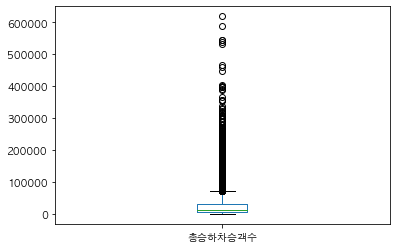

In [29]:
bs_merge['총승하차승객수'].plot(kind='box')

In [30]:
bs_group_1 = bs_merge[bs_merge['총승하차승객수']<40000]
bs_group_2 = bs_merge[bs_merge['총승하차승객수']>=40000]

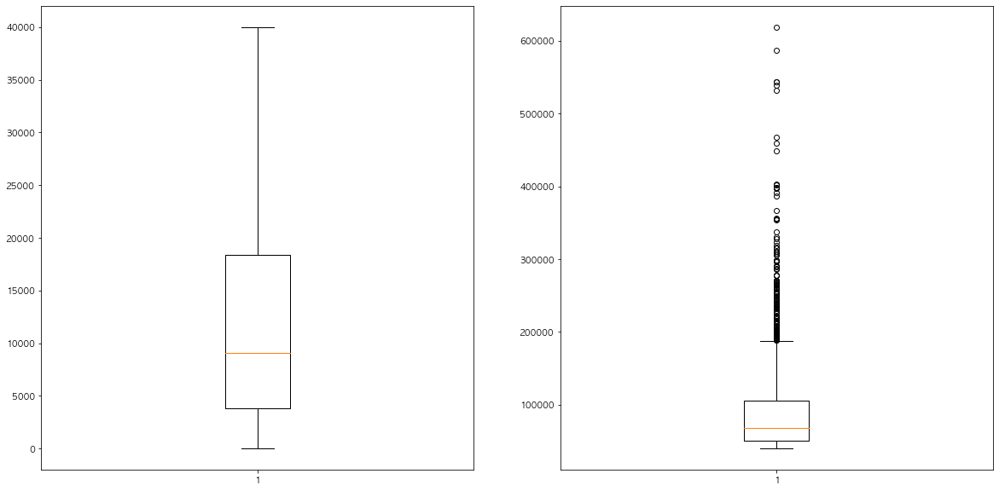

In [31]:
fig = plt.figure(figsize=(20, 10))

ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

ax1.boxplot(bs_group_1['총승하차승객수'])
ax2.boxplot(bs_group_2['총승하차승객수'])

plt.show()

In [32]:
bs_group_1['총승하차승객수'].describe()

count     8469.000000
mean     12208.967056
std      10223.056443
min          7.000000
25%       3850.000000
50%       9097.000000
75%      18378.000000
max      39998.000000
Name: 총승하차승객수, dtype: float64

In [33]:
bs_group_2['총승하차승객수'].describe()

count      2095.000000
mean      89681.528878
std       61936.215511
min       40003.000000
25%       51215.500000
50%       68765.000000
75%      106066.000000
max      618606.000000
Name: 총승하차승객수, dtype: float64

In [34]:
bs_group_2.shape

(2095, 5)

# 총하차승객수를 기준으로 5개의 그룹으로 분리

In [35]:
bs_merge['총승하차승객수'].astype('float')

0         30862.0
1        141539.0
2        189258.0
3         46309.0
4        130017.0
           ...   
10559      2555.0
10560      8703.0
10561      4035.0
10562      2336.0
10563      4531.0
Name: 총승하차승객수, Length: 10564, dtype: float64

In [36]:
# 분리 기준
mark1 = bs_merge['총승하차승객수'].quantile(0.2)
mark2 = bs_merge['총승하차승객수'].quantile(0.4)
mark3 = bs_merge['총승하차승객수'].quantile(0.6)
mark4 = bs_merge['총승하차승객수'].quantile(0.8)

In [37]:
bs_mark1 = bs_merge[bs_merge['총승하차승객수']<mark1]
bs_mark2 = bs_merge[(bs_merge['총승하차승객수']>=mark1) & (bs_merge['총승하차승객수']<mark2)]
bs_mark3 = bs_merge[(bs_merge['총승하차승객수']>=mark2) & (bs_merge['총승하차승객수']<mark3)]
bs_mark4 = bs_merge[(bs_merge['총승하차승객수']>=mark3) & (bs_merge['총승하차승객수']<mark4)]
bs_mark5 = bs_merge[bs_merge['총승하차승객수']>=mark4]

In [38]:
print(bs_mark1.shape)
print(bs_mark2.shape)
print(bs_mark3.shape)
print(bs_mark4.shape)
print(bs_mark5.shape)

(2112, 5)
(2114, 5)
(2112, 5)
(2113, 5)
(2113, 5)


# Bus_Station_Folium 라이브러리

In [39]:
bs_seoul_map = folium.Map(location=[37.55,126.98])

In [40]:
bs_mark1

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
68,100000053,승가사입구,126.956345,37.611587,2543
92,100000078,청계1가.광교,126.984908,37.568608,2637
93,100000079,청계2가.수표교,126.990686,37.568322,2494
94,100000080,청계4가.세운교,126.996492,37.568858,1695
134,100000155,청계3가.관수교,126.993789,37.568609,1680
...,...,...,...,...,...
10548,124900070,한영중고,127.156007,37.547900,1181
10557,124900055,강일리버파크1단지.금화사,127.173379,37.566976,2901
10558,124900066,강일리버파크6단지,127.175532,37.563939,245
10559,124900067,강일리버파크6단지610동,127.175786,37.565196,2555


In [41]:
bs_mark1.columns

Index(['표준ID', '정류소명', 'X좌표', 'Y좌표', '총승하차승객수'], dtype='object')

In [42]:
# Mark1
for name, lng, lat in zip(bs_mark1['정류소명'], bs_mark1['X좌표'], bs_mark1['Y좌표']):
    folium.CircleMarker([lat, lng],
                       radius=0.1,
                       fill=True,
                       color='ivory',
                       full_color='ivory',
                       fill_opacity=0.7,
                       popup=name
                       ).add_to(bs_seoul_map)
# Mark2
for name, lng, lat in zip(bs_mark2['정류소명'], bs_mark2['X좌표'], bs_mark2['Y좌표']):
    folium.CircleMarker([lat, lng],
                       radius=0.1,
                       fill=True,
                       color='lightsalmon',
                       full_color='lightsalmon',
                       fill_opacity=0.7,
                       popup=name
                       ).add_to(bs_seoul_map)
# Mark3
for name, lng, lat in zip(bs_mark3['정류소명'], bs_mark3['X좌표'], bs_mark3['Y좌표']):
    folium.CircleMarker([lat, lng],
                       radius=0.1,
                       fill=True,
                       color='orangred',
                       full_color='orangred',
                       fill_opacity=0.7,
                       popup=name
                       ).add_to(bs_seoul_map)
# Mark4
for name, lng, lat in zip(bs_mark4['정류소명'], bs_mark4['X좌표'], bs_mark4['Y좌표']):
    folium.CircleMarker([lat, lng],
                       radius=0.1,
                       fill=True,
                       color='red',
                       full_color='red',
                       fill_opacity=0.7,
                       popup=name
                       ).add_to(bs_seoul_map)
# Mark5
for name, lng, lat in zip(bs_mark5['정류소명'], bs_mark5['X좌표'], bs_mark5['Y좌표']):
    folium.CircleMarker([lat, lng],
                       radius=0.1,
                       fill=True,
                       color='darkred',
                       full_color='darkred',
                       fill_opacity=0.7,
                       popup=name
                       ).add_to(bs_seoul_map)

In [43]:
bs_seoul_map

# Bus_Station_Top_mark2

In [44]:
bs_seoul_top2_map = folium.Map(location=[37.55,126.98])

In [45]:
# Mark4
for name, lng, lat in zip(bs_mark4['정류소명'], bs_mark4['X좌표'], bs_mark4['Y좌표']):
    folium.CircleMarker([lat, lng],
                       radius=0.1,
                       fill=True,
                       color='red',
                       full_color='red',
                       fill_opacity=0.7,
                       popup=name
                       ).add_to(bs_seoul_top2_map)
# Mark5
for name, lng, lat in zip(bs_mark5['정류소명'], bs_mark5['X좌표'], bs_mark5['Y좌표']):
    folium.CircleMarker([lat, lng],
                       radius=0.1,
                       fill=True,
                       color='darkred',
                       full_color='darkred',
                       fill_opacity=0.7,
                       popup=name
                       ).add_to(bs_seoul_top2_map)

In [46]:
bs_seoul_top2_map

# CSV로 저장

In [47]:
bs_seoul_merge = bs_merge
bs_seoul_merge.reset_index(drop=True, inplace=True)
bs_seoul_merge

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
0,100000001,종로2가사거리,126.987786,37.569764,30862
1,100000002,창경궁.서울대학교병원,126.996520,37.579179,141539
2,100000003,명륜3가.성대입구,126.998290,37.582709,189258
3,100000004,종로2가.삼일교,126.987507,37.568582,46309
4,100000005,혜화동로터리.여운형활동터,127.001694,37.586230,130017
...,...,...,...,...,...
10559,124900067,강일리버파크6단지610동,127.175786,37.565196,2555
10560,124900057,강일리버파크1단지정문,127.172917,37.568143,8703
10561,124900060,고덕리엔파크3단지.2단지,127.172576,37.557130,4035
10562,124900111,가래여울,127.168974,37.576545,2336


In [48]:
bs_seoul_top2 = bs_mark4
bs_seoul_top2.reset_index(drop=True, inplace=True)
bs_seoul_top2

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
0,100000001,종로2가사거리,126.987786,37.569764,30862
1,100000006,경기상고,126.969433,37.587574,24198
2,100000008,경기상고,126.969670,37.587171,21258
3,100000009,경복고교,126.971044,37.585112,22374
4,100000011,자하문고개.윤동주문학관,126.967128,37.592194,19241
...,...,...,...,...,...
2108,124900041,암사시장,127.134171,37.546480,24195
2109,124900043,강동농협,127.135843,37.548439,25392
2110,124900045,성덕고등학교,127.143388,37.550711,21673
2111,124900089,암사종합시장,127.128259,37.549711,19527


In [49]:
bs_seoul_top1 = bs_mark5
bs_seoul_top1.reset_index(drop=True, inplace=True)
bs_seoul_top1

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
0,100000002,창경궁.서울대학교병원,126.996520,37.579179,141539
1,100000003,명륜3가.성대입구,126.998290,37.582709,189258
2,100000004,종로2가.삼일교,126.987507,37.568582,46309
3,100000005,혜화동로터리.여운형활동터,127.001694,37.586230,130017
4,101000305,서대문역사거리,126.966961,37.566208,96984
...,...,...,...,...,...
2108,124000196,강동구청역농협중앙회,127.119842,37.529087,42434
2109,124000445,중앙보훈병원역2번출구,127.148325,37.528632,54975
2110,124000446,중앙보훈병원역3번출구,127.148835,37.529561,56262
2111,124900017,상일동역3.4번출구,127.168558,37.556984,44456


In [50]:
bs_seoul_top1.to_csv('data/bus_station/bs_seoul_top1.csv')
bs_seoul_top2.to_csv('data/bus_station/bs_seoul_top2.csv')
bs_seoul_merge.to_csv('data/bus_station/bs_seoul_merge.csv')

# bs_merge Geocoding

In [51]:
bs_merge

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
0,100000001,종로2가사거리,126.987786,37.569764,30862
1,100000002,창경궁.서울대학교병원,126.996520,37.579179,141539
2,100000003,명륜3가.성대입구,126.998290,37.582709,189258
3,100000004,종로2가.삼일교,126.987507,37.568582,46309
4,100000005,혜화동로터리.여운형활동터,127.001694,37.586230,130017
...,...,...,...,...,...
10559,124900067,강일리버파크6단지610동,127.175786,37.565196,2555
10560,124900057,강일리버파크1단지정문,127.172917,37.568143,8703
10561,124900060,고덕리엔파크3단지.2단지,127.172576,37.557130,4035
10562,124900111,가래여울,127.168974,37.576545,2336


In [52]:
bs_merge.columns

Index(['표준ID', '정류소명', 'X좌표', 'Y좌표', '총승하차승객수'], dtype='object')

In [53]:
geometry = [Point(xy) for xy in zip(bs_merge['X좌표'], bs_merge['Y좌표'])]
geometry[:5]

In [54]:
bs_location = gpd.GeoDataFrame(bs_merge, crs = {'init' : 'epsg:4326'}, geometry = geometry)
bs_location.head()

/opt/anaconda3/lib/python3.8/site-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,표준ID,정류소명,X좌표,Y좌표,총승하차승객수,geometry
0,100000001,종로2가사거리,126.987786,37.569764,30862,POINT (126.98779 37.56976)
1,100000002,창경궁.서울대학교병원,126.996520,37.579179,141539,POINT (126.99652 37.57918)
2,100000003,명륜3가.성대입구,126.998290,37.582709,189258,POINT (126.99829 37.58271)
3,100000004,종로2가.삼일교,126.987507,37.568582,46309,POINT (126.98751 37.56858)
4,100000005,혜화동로터리.여운형활동터,127.001694,37.586230,130017,POINT (127.00169 37.58623)


In [60]:
type(bs_location)

geopandas.geodataframe.GeoDataFrame

In [61]:
bs_location['geometry'].to_file('data/bus_station/shp/bs_location/bs_location.shp')

# bs_mark5 Geocoding

In [62]:
bs_mark5.head()

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
0,100000002,창경궁.서울대학교병원,126.996520,37.579179,141539
1,100000003,명륜3가.성대입구,126.998290,37.582709,189258
2,100000004,종로2가.삼일교,126.987507,37.568582,46309
3,100000005,혜화동로터리.여운형활동터,127.001694,37.586230,130017
4,101000305,서대문역사거리,126.966961,37.566208,96984


In [63]:
bs_mark5.columns

Index(['표준ID', '정류소명', 'X좌표', 'Y좌표', '총승하차승객수'], dtype='object')

In [64]:
geometry_mark5 = [Point(xy) for xy in zip(bs_mark5['X좌표'], bs_mark5['Y좌표'])]
geometry_mark5[:5]

In [65]:
bs_location_top1 = gpd.GeoDataFrame(bs_mark5, crs = {'init' : 'epsg:4326'}, geometry = geometry_mark5)
bs_location_top1.head()

/opt/anaconda3/lib/python3.8/site-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,표준ID,정류소명,X좌표,Y좌표,총승하차승객수,geometry
0,100000002,창경궁.서울대학교병원,126.996520,37.579179,141539,POINT (126.99652 37.57918)
1,100000003,명륜3가.성대입구,126.998290,37.582709,189258,POINT (126.99829 37.58271)
2,100000004,종로2가.삼일교,126.987507,37.568582,46309,POINT (126.98751 37.56858)
3,100000005,혜화동로터리.여운형활동터,127.001694,37.586230,130017,POINT (127.00169 37.58623)
4,101000305,서대문역사거리,126.966961,37.566208,96984,POINT (126.96696 37.56621)


# bs_mark4 Geocoding

In [66]:
bs_mark4.head()

,표준ID,정류소명,X좌표,Y좌표,총승하차승객수
0,100000001,종로2가사거리,126.987786,37.569764,30862
1,100000006,경기상고,126.969433,37.587574,24198
2,100000008,경기상고,126.969670,37.587171,21258
3,100000009,경복고교,126.971044,37.585112,22374
4,100000011,자하문고개.윤동주문학관,126.967128,37.592194,19241


In [67]:
bs_mark4.columns

Index(['표준ID', '정류소명', 'X좌표', 'Y좌표', '총승하차승객수'], dtype='object')

In [68]:
geometry_mark4 = [Point(xy) for xy in zip(bs_mark4['X좌표'], bs_mark4['Y좌표'])]
geometry_mark4[:5]

In [69]:
bs_location_top2 = gpd.GeoDataFrame(bs_mark4, crs = {'init' : 'epsg:4326'}, geometry = geometry_mark4)
bs_location_top2.head()

/opt/anaconda3/lib/python3.8/site-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,표준ID,정류소명,X좌표,Y좌표,총승하차승객수,geometry
0,100000001,종로2가사거리,126.987786,37.569764,30862,POINT (126.98779 37.56976)
1,100000006,경기상고,126.969433,37.587574,24198,POINT (126.96943 37.58757)
2,100000008,경기상고,126.969670,37.587171,21258,POINT (126.96967 37.58717)
3,100000009,경복고교,126.971044,37.585112,22374,POINT (126.97104 37.58511)
4,100000011,자하문고개.윤동주문학관,126.967128,37.592194,19241,POINT (126.96713 37.59219)


# 서울시 행정구역

In [70]:
seoul = gpd.read_file('서울시 행정구역 shp/LARD_ADM_SECT_SGG_11.shp', encoding='cp949')
seoul.head()

,ADM_SECT_C,SGG_NM,SGG_OID,COL_ADM_SE,GID,geometry
0,11740,강동구,337,11740,127,"POLYGON ((969713.132 1948846.288, 969692.451 1..."
1,11710,송파구,1969,11710,128,"POLYGON ((968640.372 1944982.492, 968640.957 1..."
2,11680,강남구,33,11680,129,"POLYGON ((958696.114 1948605.678, 959195.920 1..."
3,11650,서초구,33,11650,130,"POLYGON ((958117.753 1940073.855, 958118.398 1..."
4,11620,관악구,33,11620,131,"POLYGON ((949321.250 1944035.054, 949323.256 1..."


In [71]:
print(bs_location_top2.crs)
print(seoul.crs)

+init=epsg:4326 +type=crs
epsg:5179


In [72]:
seoul = seoul.to_crs(epsg=4326)

In [73]:
print(bs_location_top2.crs)
print(seoul.crs)

+init=epsg:4326 +type=crs
epsg:4326


# Visualization

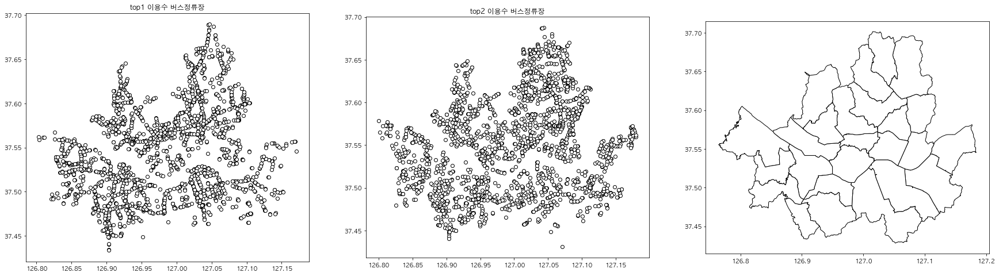

In [74]:
fig = plt.figure(figsize=(30,20))

ax1 = fig.add_subplot(1,3,1)
ax2 = fig.add_subplot(1,3,2)
ax3 = fig.add_subplot(1,3,3)

bs_location_top1.plot(ax=ax1, color="w", edgecolor="k")
ax1.set_title("top1 이용수 버스정류장")

bs_location_top2.plot(ax=ax2, color="w", edgecolor="k")
ax2.set_title("top2 이용수 버스정류장")

seoul.plot(ax=ax3,  color="w", edgecolor="k")
ax3.set_title("서울시 행정구역", color = 'w')

plt.show()

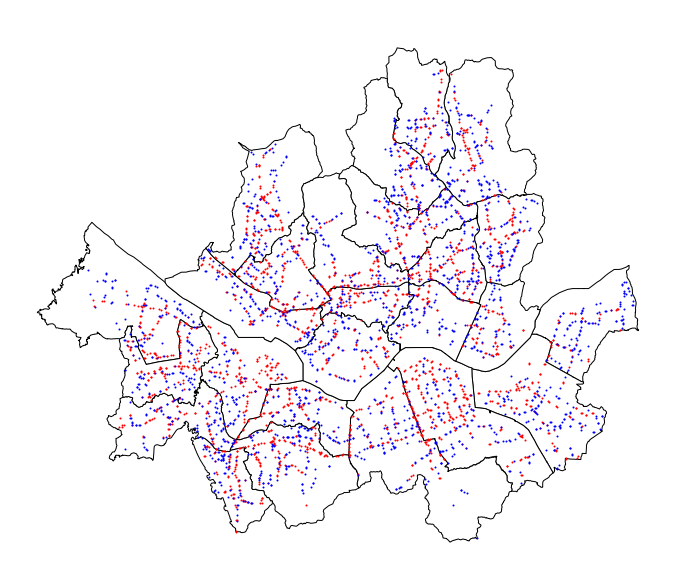

In [75]:
base = seoul.plot(color='white', edgecolor="k", figsize=(20,10))
bs_location_top1.plot(ax=base, marker='o', color='red', markersize=1)
bs_location_top2.plot(ax=base, marker='o', color='blue', markersize=1)
base.set_axis_off()
base.set_title("서울시 전기차 충전소 분포", color = 'white')
plt.show()
